In [142]:
import anndata
from bokeh import palettes
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc

import scvi

In [99]:
import matplotlib as mpl
params = {
    'font.family': "Helvetica",
    'figure.dpi': 300
   }
mpl.rcParams.update(params)
mpl.rc('savefig', dpi=300)

In [ ]:
data_directory = "/path/to/KPTracer-Data/"

In [100]:
adata_raw = sc.read_10x_mtx(f"{data_directory}/expression/raw/NT/mm10/") 

adata_processed = sc.read_h5ad(f"{data_directory}/expression/adata_processed.nt.h5ad")
adata_l46 = sc.read_10x_mtx(f"{data_directory}/expression/raw/Normal/filtered_feature_bc_matrix/")

## Annotate Lung cells from L46

In [101]:
adata_l46.raw = adata_l46

In [102]:
sc.pp.filter_cells(adata_l46, min_genes=200)
sc.pp.filter_genes(adata_l46, min_cells=0.01*adata_l46.shape[0])

In [103]:
adata_l46.layers["counts"] = adata_l46.X.copy() # preserve counts

target_sum = np.median(np.array(adata_l46.X.sum(axis=1)))
sc.pp.normalize_total(adata_l46, target_sum=target_sum)
sc.pp.log1p(adata_l46)

In [104]:
sc.pp.highly_variable_genes(
    adata_l46,
    flavor="seurat_v3",
    n_top_genes=4000,
    layer="counts",
    subset=True
)

/home/eecs/mattjones/.local/lib/python3.7/site-packages/scanpy/preprocessing/_highly_variable_genes.py:144: FutureWarning: Slicing a positional slice with .loc is not supported, and will raise TypeError in a future version.  Use .loc with labels or .iloc with positions instead.
  df.loc[: int(n_top_genes), 'highly_variable'] = True


In [105]:
scvi.data.setup_anndata(adata_l46,
                        layer="counts",
                       )

INFO     No batch_key inputted, assuming all cells are same batch                            
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              


/home/eecs/mattjones/.local/lib/python3.7/site-packages/sklearn/utils/deprecation.py:86: FutureWarning: Function setup_anndata is deprecated; Please use the model-specific setup_anndata methods instead. The global method will be removed in version 0.15.0.
  warnings.warn(msg, category=FutureWarning)


INFO     Successfully registered anndata object containing 14424 cells, 4000 vars, 1 batches,
         1 labels, and 0 proteins. Also registered 0 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


In [110]:
scvi.settings.seed = 1233431
model = scvi.model.SCVI(adata_l46, n_latent=10)

Global seed set to 1233431


In [111]:
model.train(max_epochs=150, plan_kwargs = {"lr": 1e-3}, check_val_every_n_epoch=10, use_gpu = True, early_stopping = True)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2]


Epoch 150/150: 100%|██████████| 150/150 [03:26<00:00,  1.38s/it, loss=1.08e+03, v_num=1]


In [112]:
Z_hat = model.get_latent_representation()

In [113]:
random_state = np.random.RandomState(1233431)

adata_l46.obsm["X_scVI"] = Z_hat

sc.pp.neighbors(adata_l46, use_rep="X_scVI", n_neighbors=50)
sc.tl.umap(adata_l46, min_dist=0.15, random_state=random_state)

sc.tl.leiden(adata_l46, resolution=0.4)

In [114]:
multi_calls = pd.read_csv("/data/yosef2/users/mattjones/projects/kptc/RNA/scRNA_L46/tag_calls_per_cell.csv", sep=',', index_col = 0)

tag_to_sample = {'CMO303': 'Lung', 'CMO301': 'Organoid', 'CMO302': 'Kidney', 'CMO304': 'Liver', 'Negative': 'Negative', 'Doublet': 'Doublet'}

In [115]:
adata_l46.obs['MULTI'] = 'Negative'
adata_l46.obs['MULTI'] = adata_l46.obs.apply(lambda x: multi_calls.loc[x.name, 'feature_call'] if x.name in multi_calls.index else 'Negative', axis=1)

adata_l46.obs["MULTI"] = adata_l46.obs.apply(lambda x: x.MULTI if '|' not in x.MULTI else 'Doublet', axis=1)
adata_l46.obs['Sample'] = adata_l46.obs['MULTI'].map(tag_to_sample)

In [116]:
adata_l46_raw = adata_l46.raw.to_adata()

adata_l46_raw.layers["counts"] = adata_l46_raw.X.copy() # preserve counts

adata_l46_raw.layers['logged'] = adata_l46_raw.X.copy()

scale_factor = np.median(np.array(adata_l46_raw.X.sum(axis=1)))
sc.pp.normalize_total(adata_l46_raw, target_sum=scale_factor, layers=['logged'])

sc.pp.log1p(adata_l46_raw, layer='logged')

adata_l46_raw.layers['scaled'] = sc.pp.scale(adata_l46_raw.layers['logged'], zero_center=True, copy=True)


... storing 'MULTI' as categorical
... storing 'Sample' as categorical
... storing 'feature_types' as categorical


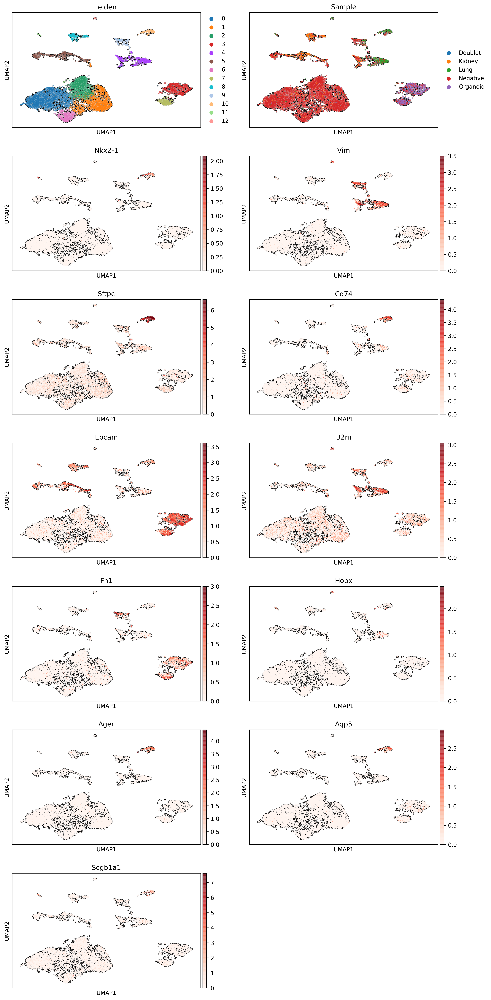

In [117]:
sc.pl.umap(adata_l46_raw, color=['leiden', 'Sample', 'Nkx2-1', 'Vim', 'Sftpc', 'Cd74',
                                 'Epcam', 'B2m', 'Fn1', 'Hopx', 'Ager', 'Aqp5', 'Scgb1a1'], layer='logged', add_outline=True, cmap='Reds', use_raw=False, ncols=2)

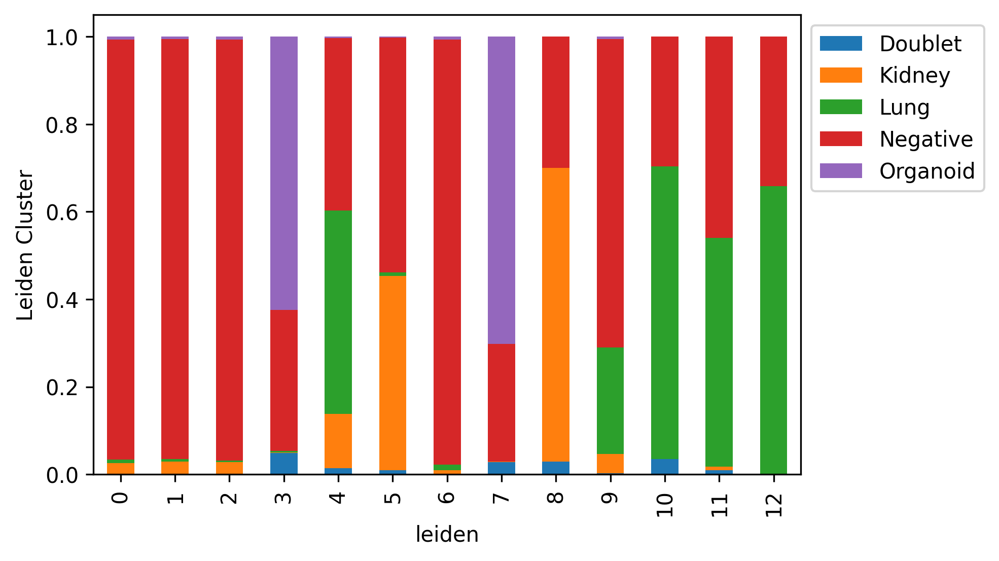

In [118]:
x = adata_l46.obs.groupby(by = ['leiden', 'Sample']).size() / adata_l46.obs.groupby(by = 'leiden').size()
piv = x.unstack()
ax = piv.plot(kind = 'bar', stacked=True)
plt.ylabel('Leiden Cluster')
ax.legend(bbox_to_anchor=(1,1))

plt.show()

/home/eecs/mattjones/.local/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


{'mainplot_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f9d72aefac8>,
 'gene_group_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f9d72c27da0>,
 'color_legend_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f9df51a0be0>}

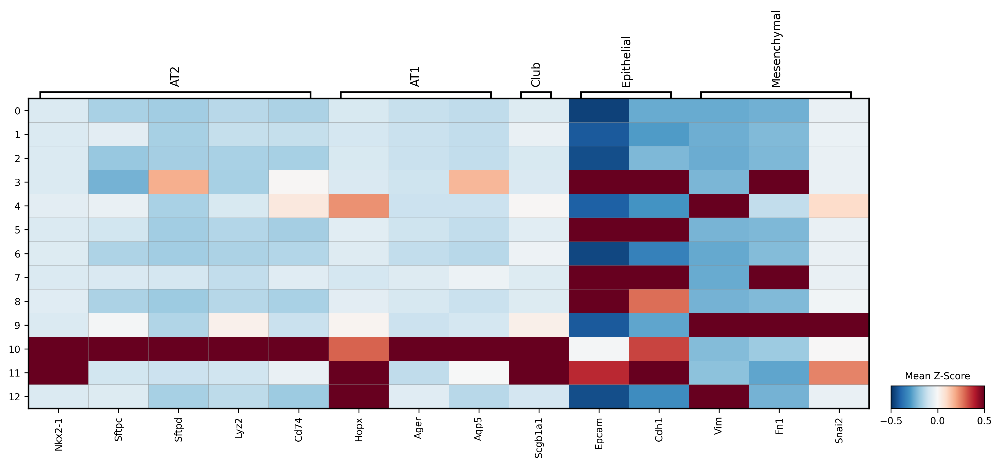

In [119]:
genes = {'AT2': ['Nkx2-1', 'Sftpc', 'Sftpd', 'Lyz2', 'Cd74'],
        'AT1': ['Hopx', 'Ager', 'Aqp5'],
         'Club': ['Scgb1a1'],
         'Epithelial': ['Epcam', 'Cdh1'],
        'Mesenchymal': ['Vim', 'Fn1', 'Snai2']}

sc.pl.matrixplot(adata_l46_raw, genes, 'leiden', dendrogram=False,
                 colorbar_title='Mean Z-Score', vmin=-0.5, vmax=0.5, layer='scaled', cmap='RdBu_r', 
                 show=False, figsize=(15,5))

In [120]:
at2_adata = adata_l46[(adata_l46.obs['leiden'].isin(['10'])) & (adata_l46.obs['Sample'] != 'Doublet')].raw.to_adata()

## Merge in AT1/2 to Tumor Data

In [121]:
adata_nt_raw = adata_raw[adata_processed.obs_names,:]
adata_nt_raw.obs = adata_processed.obs.copy()

In [122]:
adata_nt_raw = adata_nt_raw[adata_nt_raw.obs['is_normal'] == False]

/home/eecs/mattjones/.local/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [123]:
at2_adata.obs[adata_nt_raw.obs.columns] = 'N/A'

at2_adata.obs['Batch_Library'] = 'L46'
at2_adata.obs['Lane'] = 'L46'
at2_adata.obs['is_normal'] = True

adata_nt_raw = anndata.concat([adata_nt_raw, at2_adata])

In [124]:
adata_nt_raw

AnnData object with n_obs × n_vars = 58829 × 26599
    obs: 'TS_Present', 'RNA_Present', 'MULTI', 'TS_UMI', 'NUM_INTBC', 'Lane', 'Tumor', 'SubTumor', 'ES_clone', 'genotype', 'Aging_time', 'Mouse', 'Aging_Month', 'Batch_Library', 'Batch_Harvest', 'Aging_Time', 'MetFamily', 'lentiBC', 'LentiFiltered', 'is_normal', 'PercentUncut', 'leiden', 'n_counts', 'leiden_sub'

## Run scVI

In [125]:
adata_nt_raw.raw = adata_nt_raw

In [126]:
adata_nt_raw.layers['counts'] = adata_nt_raw.X.copy()

adata_nt_raw.layers['logged'] = adata_nt_raw.X.copy()

scale_factor = np.median(np.array(adata_nt_raw.X.sum(axis=1)))
sc.pp.normalize_total(adata_nt_raw, target_sum=scale_factor, layers=['logged'])

sc.pp.log1p(adata_nt_raw, layer='logged')

In [127]:
sc.pp.filter_genes(adata_nt_raw, min_cells=10, inplace=True)

sc.pp.highly_variable_genes(
    adata_nt_raw,
    flavor="seurat_v3",
    n_top_genes=4000,
    layer="counts",
    subset=True
)

/home/eecs/mattjones/.local/lib/python3.7/site-packages/scanpy/preprocessing/_highly_variable_genes.py:144: FutureWarning: Slicing a positional slice with .loc is not supported, and will raise TypeError in a future version.  Use .loc with labels or .iloc with positions instead.
  df.loc[: int(n_top_genes), 'highly_variable'] = True


In [128]:
scvi.data.setup_anndata(adata_nt_raw,
                        layer="counts",
                        batch_key='Batch_Library',
                       )

INFO     Using batches from adata.obs["Batch_Library"]                                       
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              


/home/eecs/mattjones/.local/lib/python3.7/site-packages/sklearn/utils/deprecation.py:86: FutureWarning: Function setup_anndata is deprecated; Please use the model-specific setup_anndata methods instead. The global method will be removed in version 0.15.0.
  warnings.warn(msg, category=FutureWarning)


INFO     Successfully registered anndata object containing 58829 cells, 4000 vars, 5 batches,
         1 labels, and 0 proteins. Also registered 0 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


In [129]:
scvi.settings.seed = 1233431
model = scvi.model.SCVI(adata_nt_raw, n_latent=10)

Global seed set to 1233431


In [130]:
model.train(max_epochs=150, plan_kwargs = {"lr": 1e-3}, check_val_every_n_epoch=10, use_gpu = True, early_stopping = True)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2]


Epoch 150/150: 100%|██████████| 150/150 [15:19<00:00,  6.13s/it, loss=1.54e+03, v_num=1]


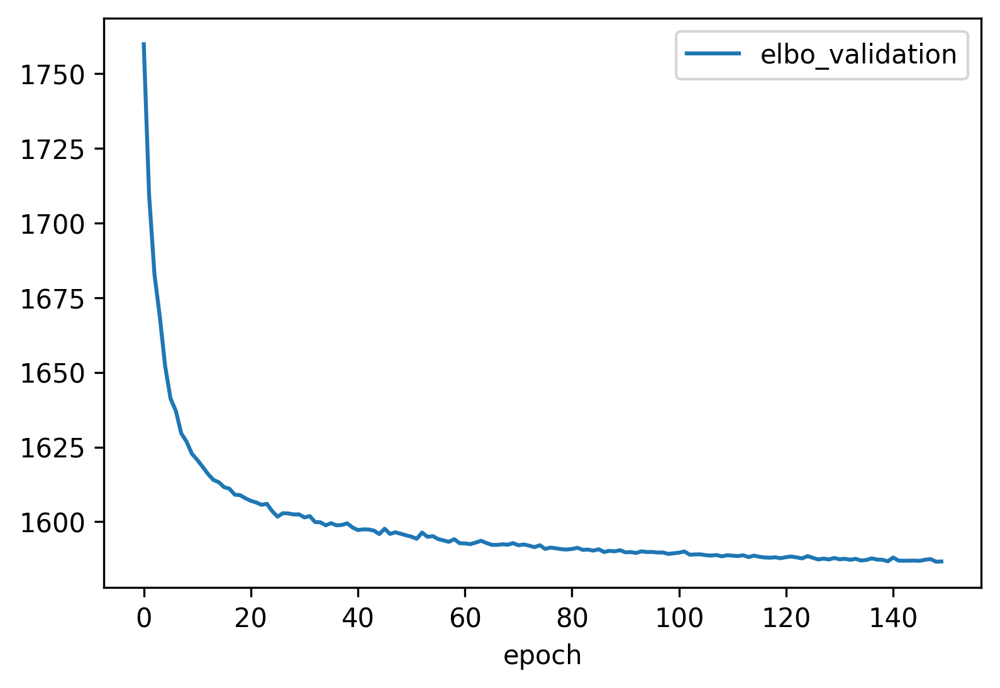

In [131]:
model.history["elbo_validation"].plot()

In [132]:
Z_hat = model.get_latent_representation()

In [162]:
random_state = np.random.RandomState(1233111)

adata_nt_raw.obsm["X_scVI"] = Z_hat

sc.pp.neighbors(adata_nt_raw, use_rep="X_scVI", n_neighbors=50)
sc.tl.umap(adata_nt_raw, min_dist=0.3, random_state=random_state)

In [163]:
adata_nt_raw.obs['Tumor'].astype(str).unique()

array(['3724_NT_T1', '3724_NT_S1', '3724_NT_L2', '3724_NT_L1',
       '3724_NT_L3', '3703_NT_T2', '3703_NT_T3', '3703_NT_T1',
       '3430_NT_T1', '3430_NT_T2', '3430_NT_T4', '3430_NT_T3',
       '3435_NT_T1', '3435_NT_T4', '3435_NT_T6', '3435_NT_T3',
       '3520_NT_T1', '3434_NT_T1', '3434_NT_T3', '3434_NT_T2', 'nan',
       '3513_NT_T1', '3513_NT_T3', '3513_NT_T2', '3513_NT_T5',
       '3513_NT_T4', '3513_NT_K1', '3513_NT_N1', '3433_NT_T1',
       '3432_NT_T1', '3433_NT_T2', '3432_NT_T2', '3730_NT_T1',
       '3726_NT_T1', '3726_NT_T2', '3730_NT_T2', 'N/A'], dtype=object)

In [164]:
adata_nt_raw.obs['is_normal'] = adata_nt_raw.obs['is_normal'].astype(str)
adata_nt_raw.obs['leiden_sub'] = adata_nt_raw.obs['leiden_sub'].astype(str)

adata_nt_raw.obs.loc[adata_nt_raw.obs['leiden_sub'] == 'N/A', 'leiden_sub'] = 'Normal'

In [165]:
clust_colors = palettes.Category20[20]
clust_colors += palettes.Spectral[3][:len(adata_nt_raw.uns['leiden_sub_colors'])-20]
adata_nt_raw.uns['leiden_sub_colors'] = clust_colors

### Figure S3B

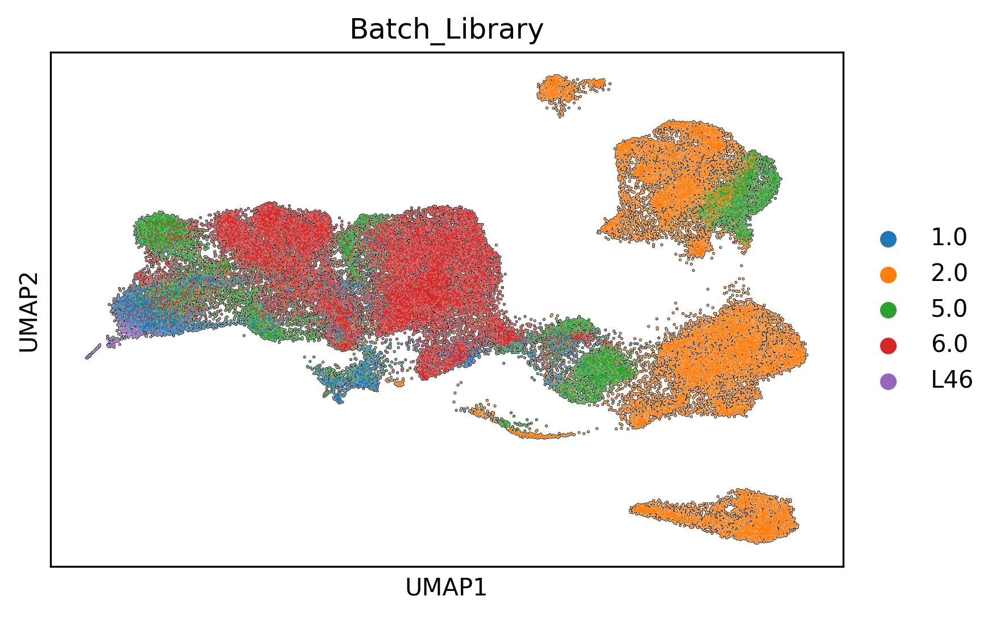

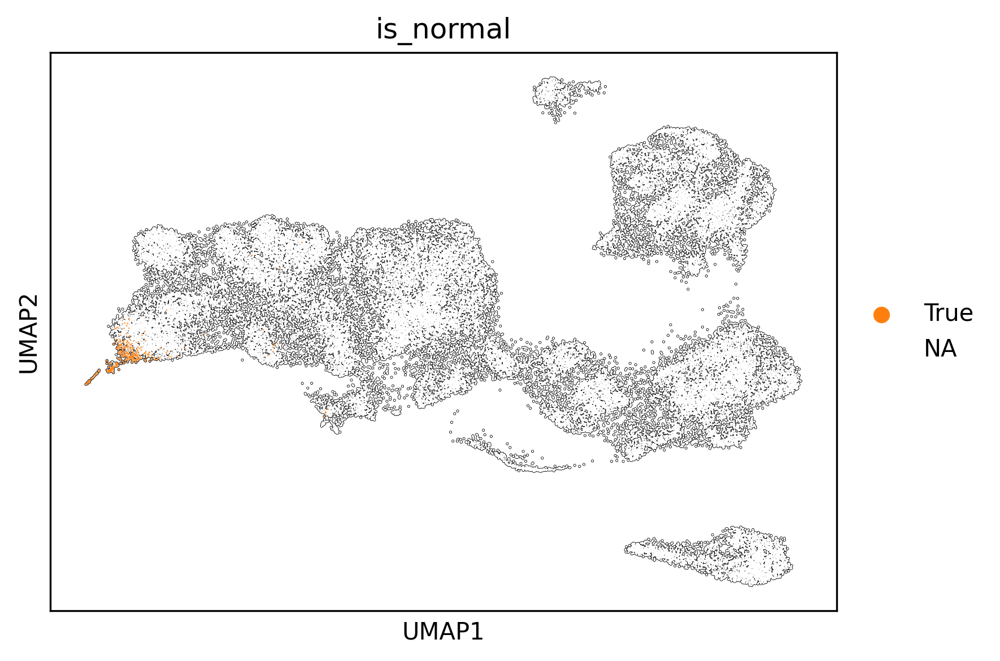

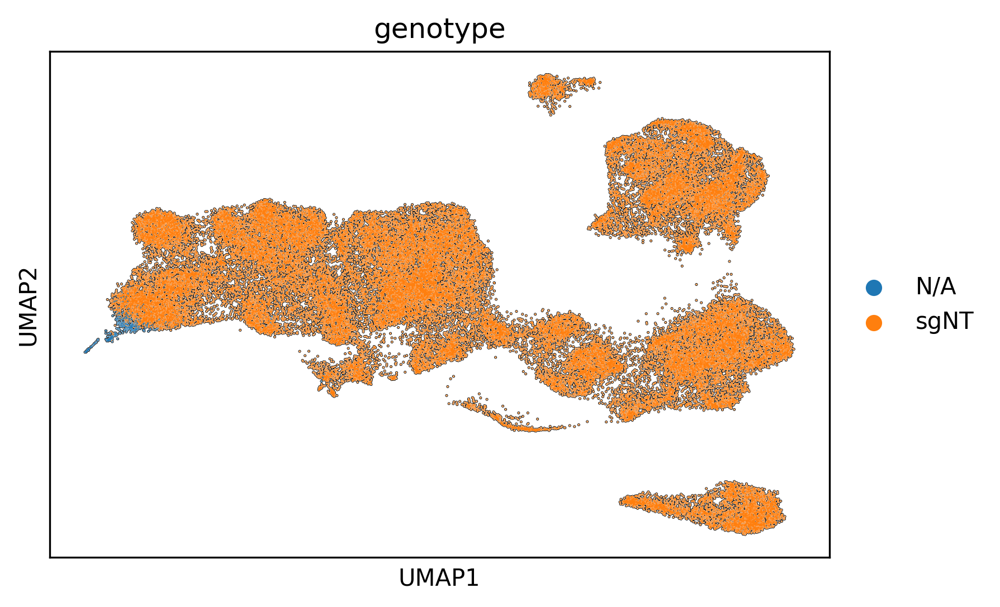

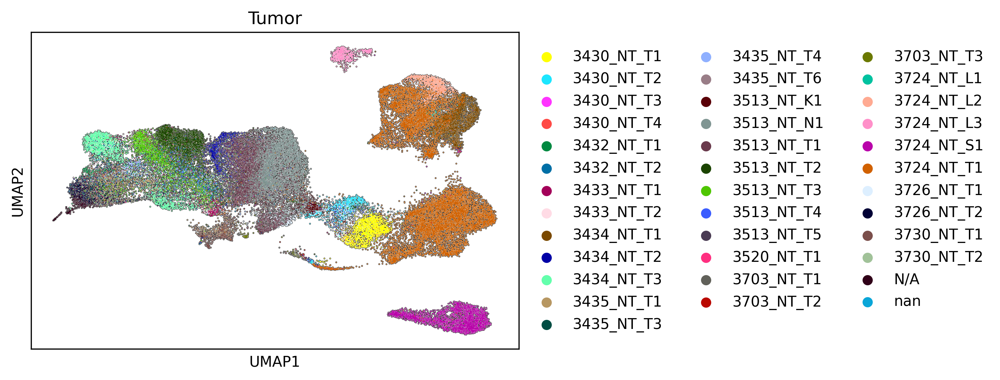

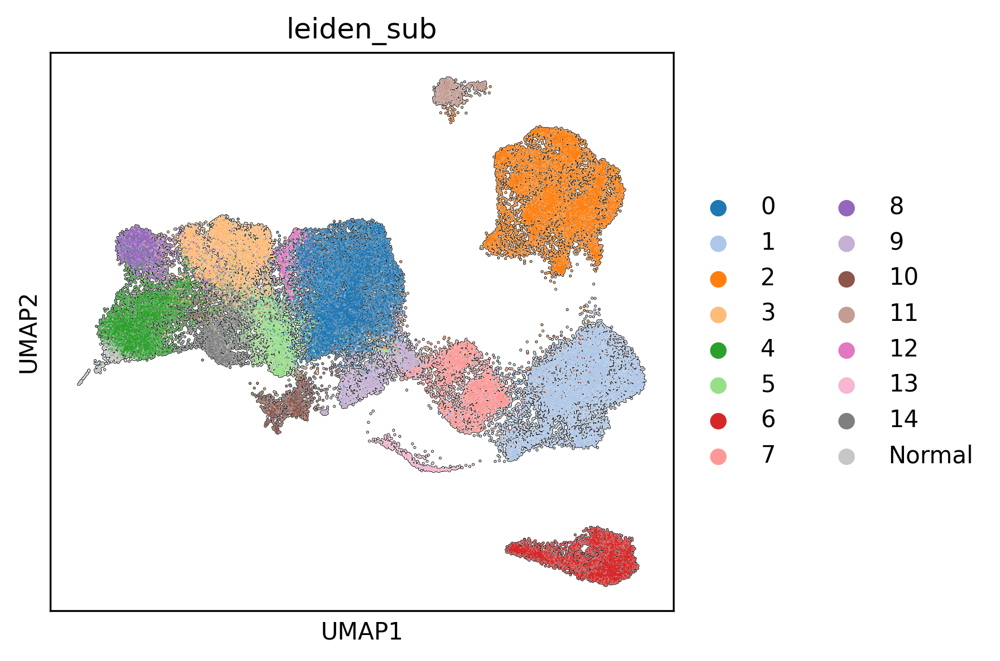

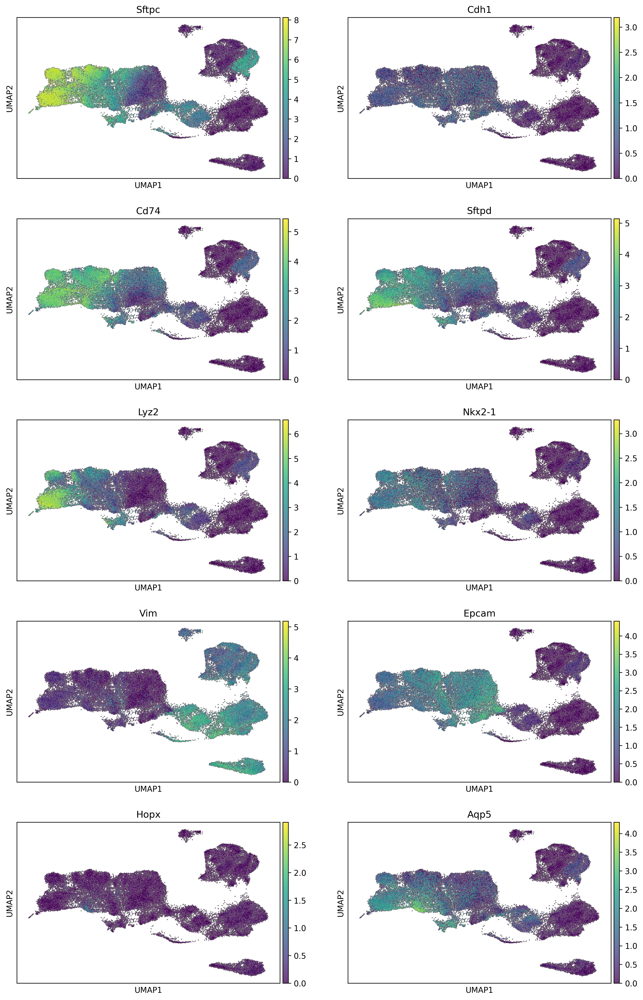

In [169]:
sc.pl.umap(adata_nt_raw, color=['Batch_Library'], add_outline=True)

sc.pl.umap(adata_nt_raw, color=['is_normal'], groups = ['True'], add_outline=True, na_color='white', show=False)
plt.tight_layout()
plt.savefig("integrated_umap_normal.png", dpi=300)
plt.show()

sc.pl.umap(adata_nt_raw, color=['genotype'], add_outline=True)

sc.pl.umap(adata_nt_raw, color=['Tumor'], add_outline=True)

sc.pl.umap(adata_nt_raw, color=['leiden_sub'], add_outline=True, show=False)
plt.tight_layout()
plt.savefig("integrated_umap_leiden.png", dpi=300)
plt.show()

sc.pl.umap(adata_nt_raw, color=['Sftpc', 'Cdh1', 'Cd74','Sftpd', 'Lyz2', 'Nkx2-1', 'Vim', 'Epcam',
                                'Hopx', 'Aqp5',], add_outline=True,
                       use_raw=False, layer='logged', ncols=2)